In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split

In [3]:
df= pd.read_csv('data.csv')
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [5]:
df["Unnamed: 32"].isnull().sum()

np.int64(569)

In [6]:
df.drop("Unnamed: 32", axis=1, inplace=True)

In [7]:
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [8]:
df.drop("id", axis=1, inplace=True)

In [9]:
df.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [10]:
df["diagnosis"].value_counts()

diagnosis
B    357
M    212
Name: count, dtype: int64

In [11]:
df["diagnosis"] = df["diagnosis"].map({'M':1, 'B':0})

In [12]:
df.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [13]:
df["diagnosis"].value_counts()

diagnosis
0    357
1    212
Name: count, dtype: int64

In [14]:
df.columns

Index(['diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')

In [15]:
df.describe().T    #No sé interpretar esto

,count,mean,std,min,25%,50%,75%,max
diagnosis,569.0,0.372583,0.483918,0.000000,0.000000,0.000000,1.000000,1.00000
radius_mean,569.0,14.127292,3.524049,6.981000,11.700000,13.370000,15.780000,28.11000
texture_mean,569.0,19.289649,4.301036,9.710000,16.170000,18.840000,21.800000,39.28000
perimeter_mean,569.0,91.969033,24.298981,43.790000,75.170000,86.240000,104.100000,188.50000
area_mean,569.0,654.889104,351.914129,143.500000,420.300000,551.100000,782.700000,2501.00000
smoothness_mean,569.0,0.096360,0.014064,0.052630,0.086370,0.095870,0.105300,0.16340
compactness_mean,569.0,0.104341,0.052813,0.019380,0.064920,0.092630,0.130400,0.34540
concavity_mean,569.0,0.088799,0.079720,0.000000,0.029560,0.061540,0.130700,0.42680
concave points_mean,569.0,0.048919,0.038803,0.000000,0.020310,0.033500,0.074000,0.20120
symmetry_mean,569.0,0.181162,0.027414,0.106000,0.161900,0.179200,0.195700,0.30400


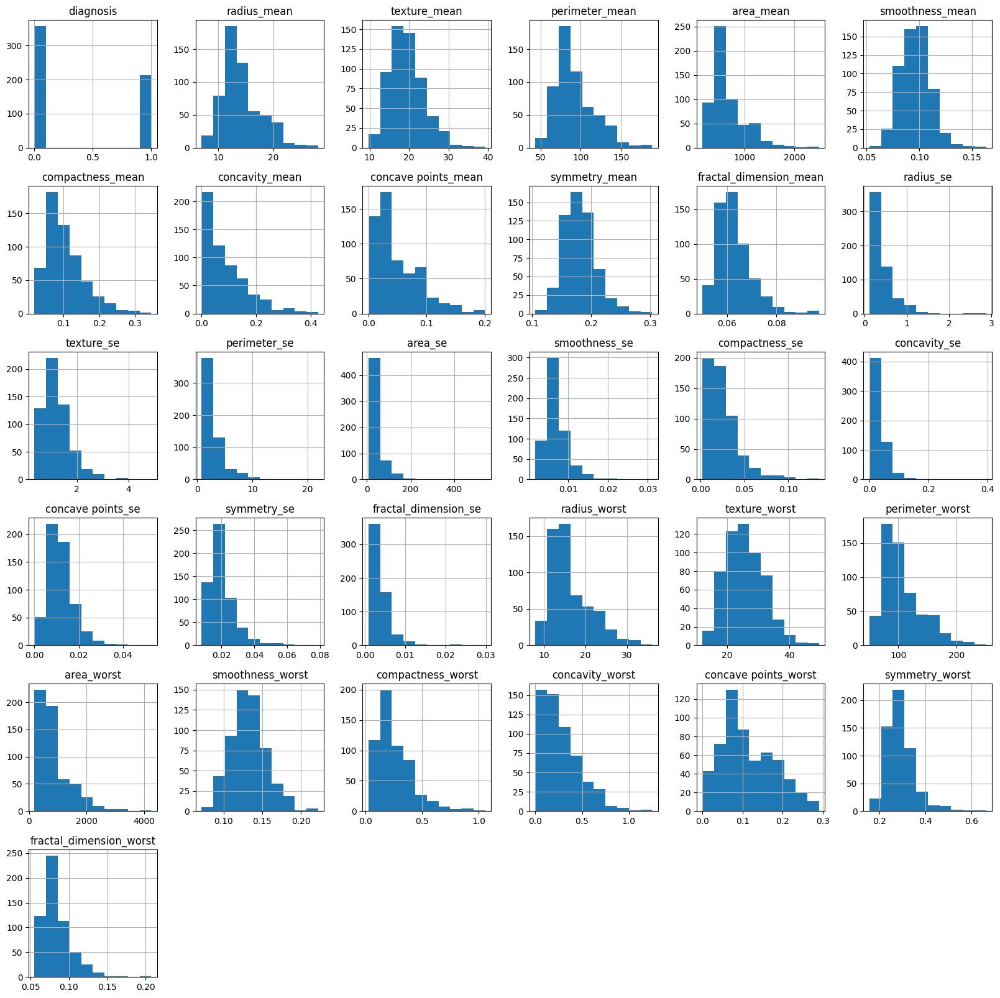

In [16]:
figsize = (20, 20)
df.hist(figsize = figsize)
plt.show()

In [17]:
figsize = (30, 30)
sns.pairplot(df, hue="diagnosis")

<Axes: >

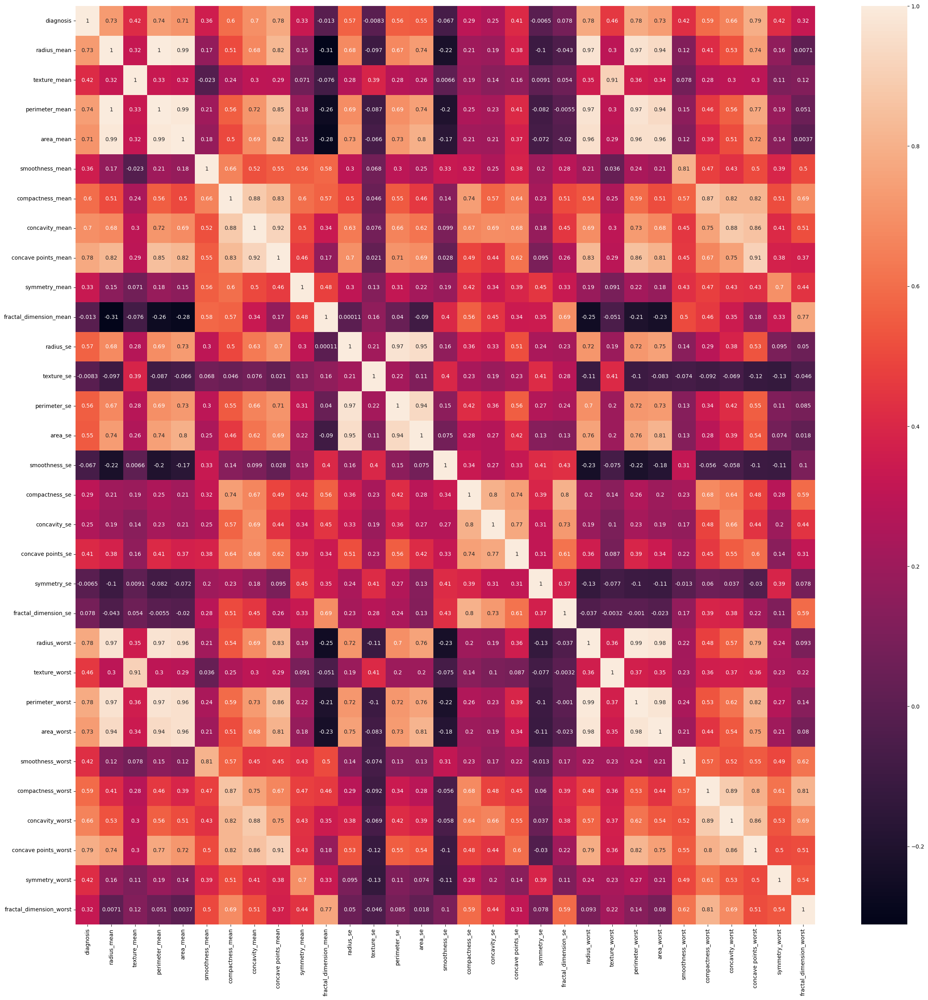

In [18]:
df_corr = df.corr()
plt.figure(figsize=(30, 30))
sns.heatmap(df_corr, annot=True)


<Axes: title={'center': 'Correlación fuerte'}>

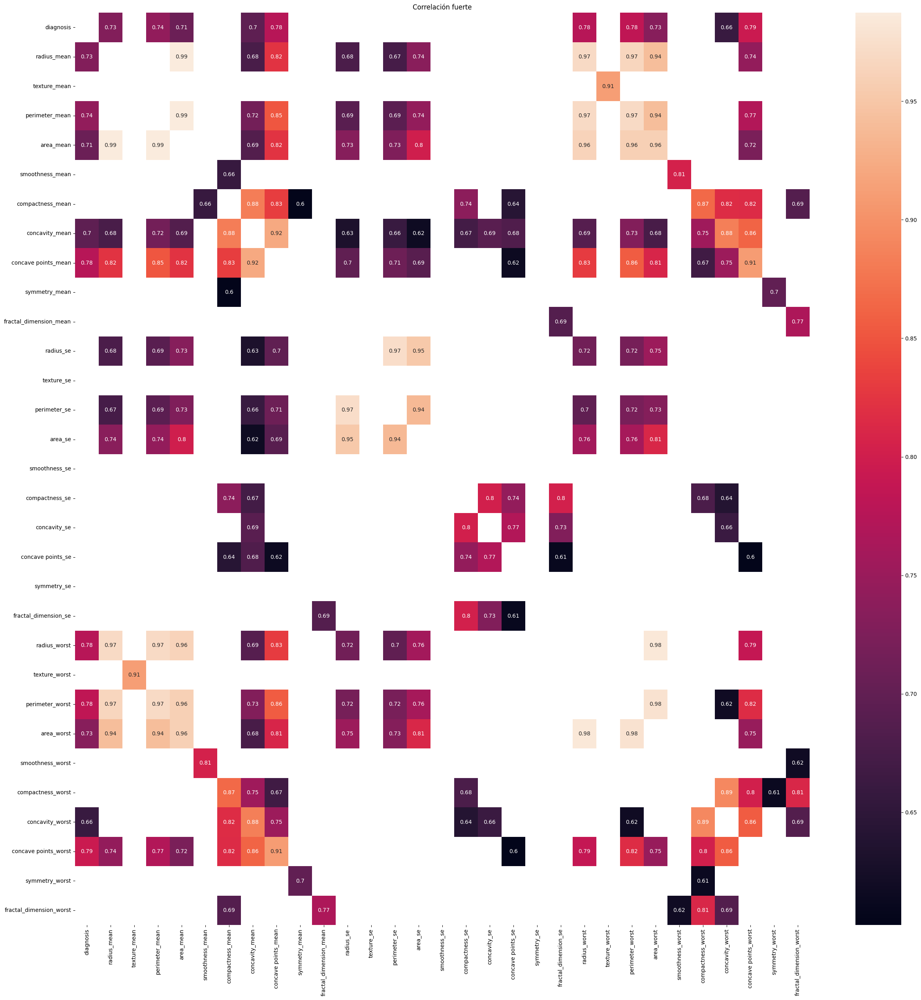

In [19]:
corr_fuerte = df_corr[(df_corr > 0.6)& (df_corr < 0.99)]
plt.figure(figsize=(30, 30))
plt.title("Correlación fuerte")
sns.heatmap(corr_fuerte, annot=True)


In [20]:
# Drop texture_se, perimeter_se, smoothness_se, symmetry_se, fractal_dimension_se, texture_mean, texture_worst, smoothness_mean, smoothness_worst, symmetry_mean, symmetry_worst, fractal_dimension_mean, fractal_dimension_worst
df.drop(
    [
        "texture_se", 
        "perimeter_se", 
        "smoothness_se", 
        "symmetry_se", 
        "fractal_dimension_se", 
        "texture_mean", 
        "texture_worst", 
        "smoothness_mean", 
        "smoothness_worst", 
        "symmetry_mean", 
        "symmetry_worst", 
        "fractal_dimension_mean", 
        "fractal_dimension_worst"
        ], 
    axis=1, 
    inplace=True
    )


In [21]:
df.head()

,diagnosis,radius_mean,perimeter_mean,area_mean,compactness_mean,concavity_mean,concave points_mean,radius_se,area_se,compactness_se,concavity_se,concave points_se,radius_worst,perimeter_worst,area_worst,compactness_worst,concavity_worst,concave points_worst
0,1,17.99,122.80,1001.0,0.27760,0.3001,0.14710,1.0950,153.40,0.04904,0.05373,0.01587,25.38,184.60,2019.0,0.6656,0.7119,0.2654
1,1,20.57,132.90,1326.0,0.07864,0.0869,0.07017,0.5435,74.08,0.01308,0.01860,0.01340,24.99,158.80,1956.0,0.1866,0.2416,0.1860
2,1,19.69,130.00,1203.0,0.15990,0.1974,0.12790,0.7456,94.03,0.04006,0.03832,0.02058,23.57,152.50,1709.0,0.4245,0.4504,0.2430
3,1,11.42,77.58,386.1,0.28390,0.2414,0.10520,0.4956,27.23,0.07458,0.05661,0.01867,14.91,98.87,567.7,0.8663,0.6869,0.2575
4,1,20.29,135.10,1297.0,0.13280,0.1980,0.10430,0.7572,94.44,0.02461,0.05688,0.01885,22.54,152.20,1575.0,0.2050,0.4000,0.1625


In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   diagnosis             569 non-null    int64  
 1   radius_mean           569 non-null    float64
 2   perimeter_mean        569 non-null    float64
 3   area_mean             569 non-null    float64
 4   compactness_mean      569 non-null    float64
 5   concavity_mean        569 non-null    float64
 6   concave points_mean   569 non-null    float64
 7   radius_se             569 non-null    float64
 8   area_se               569 non-null    float64
 9   compactness_se        569 non-null    float64
 10  concavity_se          569 non-null    float64
 11  concave points_se     569 non-null    float64
 12  radius_worst          569 non-null    float64
 13  perimeter_worst       569 non-null    float64
 14  area_worst            569 non-null    float64
 15  compactness_worst     5

In [23]:
df.isna().sum()

diagnosis               0
radius_mean             0
perimeter_mean          0
area_mean               0
compactness_mean        0
concavity_mean          0
concave points_mean     0
radius_se               0
area_se                 0
compactness_se          0
concavity_se            0
concave points_se       0
radius_worst            0
perimeter_worst         0
area_worst              0
compactness_worst       0
concavity_worst         0
concave points_worst    0
dtype: int64

In [24]:
df.duplicated().sum()

np.int64(0)

In [25]:
seleccion= ["area_worst", "perimeter_worst", "radius_worst", "concave points_worst", "diagnosis"]
print(df[seleccion].head())

   area_worst  perimeter_worst  radius_worst  concave points_worst  diagnosis
0      2019.0           184.60         25.38                0.2654          1
1      1956.0           158.80         24.99                0.1860          1
2      1709.0           152.50         23.57                0.2430          1
3       567.7            98.87         14.91                0.2575          1
4      1575.0           152.20         22.54                0.1625          1


<Figure size 3000x2500 with 0 Axes>

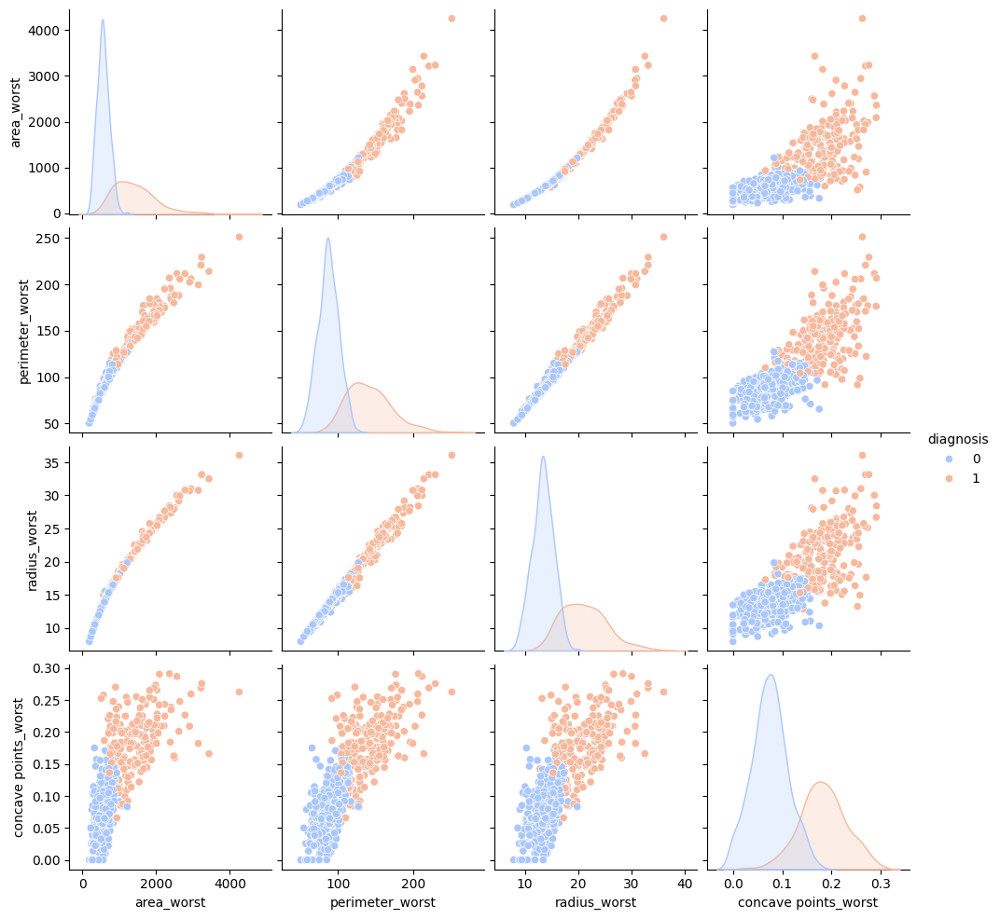

In [26]:
plt.figure(figsize=(30, 25))
sns.pairplot(df[seleccion], hue="diagnosis", palette="coolwarm", diag_kind="kde")
plt.show()

In [27]:

clase_1 = 357
clase_2 = 212

total = clase_1 + clase_2
porcentaje_1 = (clase_1 / total) * 100
porcentaje_2 = (clase_2 / total) * 100

print(f"Clase 1: {porcentaje_1:.2f}%")
print(f"Clase 2: {porcentaje_2:.2f}%")    # Esto se hace mas facil con valuecounts param props.


Clase 1: 62.74%
Clase 2: 37.26%


In [28]:
from sklearn.model_selection import train_test_split

X = df.drop("diagnosis", axis=1)
y = df["diagnosis"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(y_train.value_counts())
print(y_test.value_counts())

diagnosis
0    286
1    169
Name: count, dtype: int64
diagnosis
0    71
1    43
Name: count, dtype: int64


In [29]:
clase_X_train = 286
clase_y_train = 169

total = clase_1 + clase_2
porcentaje_X_train = (clase_X_train / total) * 100
porcentaje_y_train = (clase_y_train / total) * 100

print(f"X_train: {porcentaje_X_train:.2f}%")
print(f"y_train: {porcentaje_y_train:.2f}%")

X_train: 50.26%
y_train: 29.70%


In [30]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report


model = RandomForestClassifier(class_weight="balanced", random_state=42)
model.fit(X_train, y_train)

y_pred = model.predict(X_test)
print(classification_report(y_test, y_pred))


              precision    recall  f1-score   support

           0       0.97      0.97      0.97        71
           1       0.95      0.95      0.95        43

    accuracy                           0.96       114
   macro avg       0.96      0.96      0.96       114
weighted avg       0.96      0.96      0.96       114



In [31]:
y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)


train_acc = accuracy_score(y_train, y_train_pred)
test_acc = accuracy_score(y_test, y_test_pred)

print(f"Accuracy en Train: {train_acc:.4f}")
print(f"Accuracy en Test: {test_acc:.4f}")

print("Reporte en Train:")
print(classification_report(y_train, y_train_pred))
print("Reporte en Test:")
print(classification_report(y_test, y_test_pred))

Accuracy en Train: 0.9978
Accuracy en Test: 0.9649
Reporte en Train:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       286
           1       1.00      0.99      1.00       169

    accuracy                           1.00       455
   macro avg       1.00      1.00      1.00       455
weighted avg       1.00      1.00      1.00       455

Reporte en Test:
              precision    recall  f1-score   support

           0       0.97      0.97      0.97        71
           1       0.95      0.95      0.95        43

    accuracy                           0.96       114
   macro avg       0.96      0.96      0.96       114
weighted avg       0.96      0.96      0.96       114



In [32]:
from sklearn.model_selection import cross_val_score

cv_scores = cross_val_score(model, X_train, y_train, cv=5)

print(f"Score promedio en validación cruzada: {cv_scores.mean():.4f}")
print(f"Desviación estándar: {cv_scores.std():.4f}")

Score promedio en validación cruzada: 0.9451
Desviación estándar: 0.0170


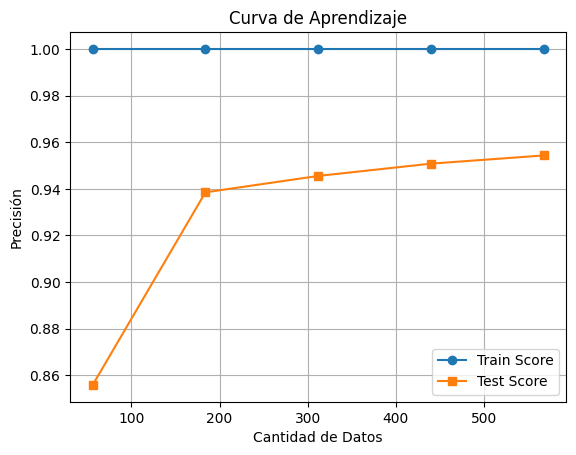

In [33]:
from sklearn.model_selection import learning_curve, LeaveOneOut



train_sizes, train_scores, test_scores = learning_curve(model, X, y, cv=LeaveOneOut(), scoring="accuracy")

train_mean, test_mean = train_scores.mean(axis=1), test_scores.mean(axis=1)


plt.plot(train_sizes, train_mean, 'o-', label="Train Score")
plt.plot(train_sizes, test_mean, 's-', label="Test Score")

plt.xlabel("Cantidad de Datos")
plt.ylabel("Precisión")
plt.title("Curva de Aprendizaje")
plt.legend()
plt.grid()
plt.show()

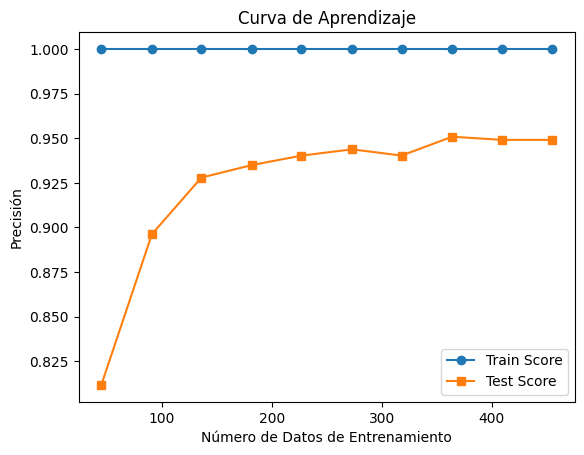

In [34]:
train_sizes, train_scores, test_scores = learning_curve(
    model, X, y, cv=5, scoring="accuracy", train_sizes=np.linspace(0.1, 1.0, 10)
)

train_mean = np.mean(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)

plt.plot(train_sizes, train_mean, label="Train Score", marker='o')
plt.plot(train_sizes, test_mean, label="Test Score", marker='s')

plt.xlabel("Número de Datos de Entrenamiento")
plt.ylabel("Precisión")
plt.title("Curva de Aprendizaje")
plt.legend()
plt.show()

In [35]:
model = RandomForestClassifier(max_depth=3,class_weight="balanced_subsample",  random_state=42)
model.fit(X_train, y_train)

y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)


train_acc = accuracy_score(y_train, y_train_pred)
test_acc = accuracy_score(y_test, y_test_pred)

print(f"Train Accuracy: {train_acc:.4f}")
print(f"Test Accuracy: {test_acc:.4f}")

print("\nReporte en Train:")
print(classification_report(y_train, y_train_pred))

print("\nReporte en Test:")
print(classification_report(y_test, y_test_pred))

Train Accuracy: 0.9648
Test Accuracy: 0.9649

Reporte en Train:
              precision    recall  f1-score   support

           0       0.98      0.97      0.97       286
           1       0.94      0.96      0.95       169

    accuracy                           0.96       455
   macro avg       0.96      0.96      0.96       455
weighted avg       0.97      0.96      0.96       455


Reporte en Test:
              precision    recall  f1-score   support

           0       0.97      0.97      0.97        71
           1       0.95      0.95      0.95        43

    accuracy                           0.96       114
   macro avg       0.96      0.96      0.96       114
weighted avg       0.96      0.96      0.96       114



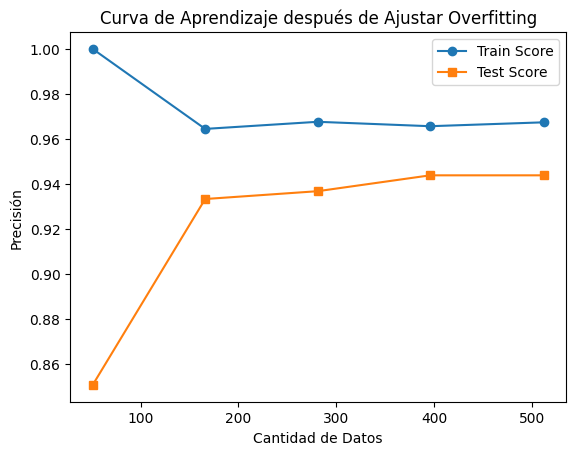

In [36]:

model = RandomForestClassifier(max_depth=3, class_weight="balanced_subsample", random_state=42)


train_sizes, train_scores, test_scores = learning_curve(model, X, y, cv=10, scoring="accuracy")


train_mean = np.mean(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)


plt.plot(train_sizes, train_mean, 'o-', label="Train Score")
plt.plot(train_sizes, test_mean, 's-', label="Test Score")


plt.xlabel("Cantidad de Datos")
plt.ylabel("Precisión")
plt.title("Curva de Aprendizaje después de Ajustar Overfitting")
plt.legend()
plt.show()


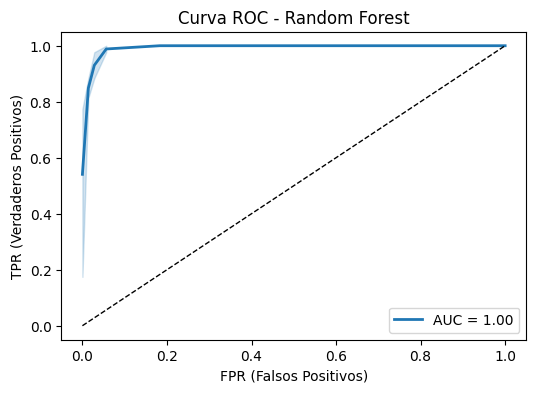

In [37]:

from sklearn.metrics import roc_curve, auc

model = RandomForestClassifier(max_depth=1,min_samples_leaf=100, class_weight="balanced_subsample", random_state=42)
model.fit(X_train, y_train)

y_probs = model.predict_proba(X_test)[:, 1]  

fpr, tpr, _ = roc_curve(y_test, y_probs)
roc_auc = auc(fpr, tpr)


plt.figure(figsize=(6,4))
sns.lineplot(x=fpr, y=tpr, label=f"AUC = {roc_auc:.2f}", linewidth=2)
plt.plot([0, 1], [0, 1], 'k--', linewidth=1) 
plt.xlabel("FPR (Falsos Positivos)")
plt.ylabel("TPR (Verdaderos Positivos)")
plt.title("Curva ROC - Random Forest")
plt.legend()
plt.show()



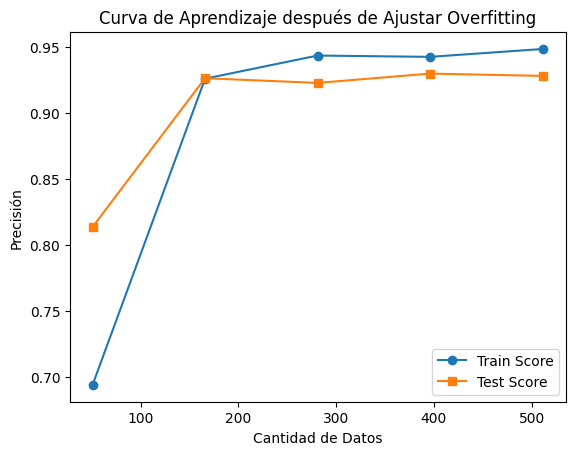

In [38]:
model = RandomForestClassifier(max_depth=3,min_samples_leaf=20, class_weight="balanced_subsample", random_state=42)


train_sizes, train_scores, test_scores = learning_curve(model, X, y, cv=10, scoring="accuracy")


train_mean = np.mean(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)


plt.plot(train_sizes, train_mean, 'o-', label="Train Score")
plt.plot(train_sizes, test_mean, 's-', label="Test Score")


plt.xlabel("Cantidad de Datos")
plt.ylabel("Precisión")
plt.title("Curva de Aprendizaje después de Ajustar Overfitting")
plt.legend()
plt.show()

In [39]:
model = RandomForestClassifier(max_depth=5,min_samples_leaf=20, class_weight="balanced_subsample", random_state=42)
model.fit(X_train, y_train)

y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)


train_acc = accuracy_score(y_train, y_train_pred)
test_acc = accuracy_score(y_test, y_test_pred)

print(f"Train Accuracy: {train_acc:.4f}")
print(f"Test Accuracy: {test_acc:.4f}")

print("\nReporte en Train:")
print(classification_report(y_train, y_train_pred))

print("\nReporte en Test:")
print(classification_report(y_test, y_test_pred))

Train Accuracy: 0.9407
Test Accuracy: 0.9649

Reporte en Train:
              precision    recall  f1-score   support

           0       0.98      0.93      0.95       286
           1       0.89      0.96      0.92       169

    accuracy                           0.94       455
   macro avg       0.93      0.95      0.94       455
weighted avg       0.94      0.94      0.94       455


Reporte en Test:
              precision    recall  f1-score   support

           0       0.99      0.96      0.97        71
           1       0.93      0.98      0.95        43

    accuracy                           0.96       114
   macro avg       0.96      0.97      0.96       114
weighted avg       0.97      0.96      0.97       114



In [40]:
model_def = RandomForestClassifier(max_depth=4,min_samples_leaf=15, class_weight="balanced_subsample", random_state=42)
model.fit(X_train, y_train)

y_train_pred = model.predict(X_train)
y_test_pred = model.predict(X_test)


train_acc = accuracy_score(y_train, y_train_pred)
test_acc = accuracy_score(y_test, y_test_pred)

print(f"Train Accuracy: {train_acc:.4f}")
print(f"Test Accuracy: {test_acc:.4f}")

print("\nReporte en Train:")
print(classification_report(y_train, y_train_pred))

print("\nReporte en Test:")
print(classification_report(y_test, y_test_pred))

Train Accuracy: 0.9407
Test Accuracy: 0.9649

Reporte en Train:
              precision    recall  f1-score   support

           0       0.98      0.93      0.95       286
           1       0.89      0.96      0.92       169

    accuracy                           0.94       455
   macro avg       0.93      0.95      0.94       455
weighted avg       0.94      0.94      0.94       455


Reporte en Test:
              precision    recall  f1-score   support

           0       0.99      0.96      0.97        71
           1       0.93      0.98      0.95        43

    accuracy                           0.96       114
   macro avg       0.96      0.97      0.96       114
weighted avg       0.97      0.96      0.97       114



In [44]:

from statsmodels.tools.tools import add_constant
from statsmodels.stats.outliers_influence import variance_inflation_factor

X_vif = add_constant(df.drop(columns=["diagnosis"]))
vif = pd.DataFrame()
vif["Variable"] = X_vif.columns
vif["VIF"] = [variance_inflation_factor(X_vif.values, i) for i in range(X_vif.shape[1])]
print(vif)

                Variable          VIF
0                  const   356.790337
1            radius_mean  3421.281334
2         perimeter_mean  3495.467230
3              area_mean   284.369068
4       compactness_mean    27.500255
5         concavity_mean    65.618570
6    concave points_mean    51.995872
7              radius_se    31.969333
8                area_se    31.516680
9         compactness_se     9.118855
10          concavity_se    13.666056
11     concave points_se     9.499621
12          radius_worst   627.634967
13       perimeter_worst   227.722095
14            area_worst   272.584746
15     compactness_worst    24.199896
16       concavity_worst    28.719910
17  concave points_worst    31.587797


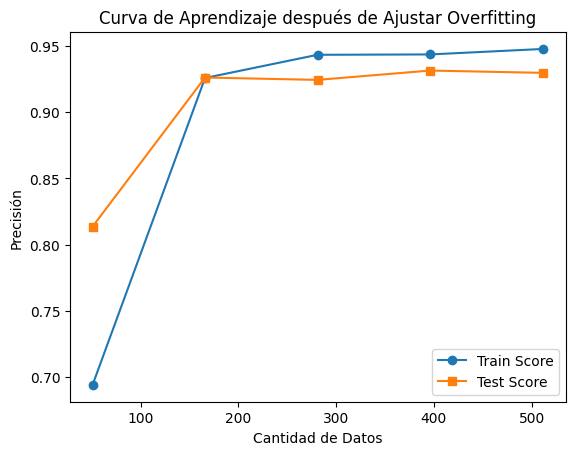

In [41]:
model_def = RandomForestClassifier(max_depth=4,min_samples_leaf=15, class_weight="balanced_subsample", random_state=42)


train_sizes, train_scores, test_scores = learning_curve(model, X, y, cv=10, scoring="accuracy")


train_mean = np.mean(train_scores, axis=1)
test_mean = np.mean(test_scores, axis=1)


plt.plot(train_sizes, train_mean, 'o-', label="Train Score")
plt.plot(train_sizes, test_mean, 's-', label="Test Score")


plt.xlabel("Cantidad de Datos")
plt.ylabel("Precisión")
plt.title("Curva de Aprendizaje después de Ajustar Overfitting")
plt.legend()
plt.show()

In [42]:
import joblib
joblib.dump(model_def, "Class_BC_RFC.joblib")


['Class_BC_RFC.joblib']